In [102]:
import os

os.environ['USE_PYGEOS'] = '0'

import geopandas
import shapely
import numpy
import osmnx as ox

In [2]:
shapely.__version__

'2.0.0'

In [5]:
sample = geopandas.read_parquet("../../data/sample.parquet")

In [7]:
sample[sample.eFUA_name == "Vienna"]

,eFUA_ID,UC_num,UC_IDs,eFUA_name,Commuting,Cntry_ISO,Cntry_name,FUA_area,UC_area,FUA_p_2015,UC_p_2015,Com_p_2015,geometry,continent,iso_a3
15,790.0,1.0,3027,Vienna,1.0,AUT,Austria,3104.0,392.0,2.381083e+06,1.856676e+06,524407.38564,"POLYGON ((16.61992 48.47642, 16.60702 48.47642...",Europe,AUT


In [100]:
type_filter = '["highway"~"living_street|motorway|motorway_link|pedestrian|primary|primary_link|residential|secondary|secondary_link|service|tertiary|tertiary_link|trunk|trunk_link"]'

In [104]:
streets_graph = ox.graph_from_polygon(sample.geometry.loc[15], network_type='all_private', custom_filter=type_filter, retain_all=True, simplify=False)
# Project graph to the local UTM zone (in meters with a reletively small error)
streets_graph = ox.projection.project_graph(streets_graph)
# Create an undirected graph to avoid duplicated geometry and convert it to a GeoDataFrame
gdf = ox.graph_to_gdfs(ox.get_undirected(streets_graph), nodes=False, edges=True, node_geometry=False, fill_edge_geometry=True)
# Ensure tags are a string and not different dtype (as list) so we can save it
gdf.highway = gdf.highway.astype(str)

In [110]:
gdf[['osmid', 'geometry']].to_file('vienna.gpkg')

In [111]:
shapely.node(gdf.geometry.array)

array([<MULTILINESTRING ((583492.137 5336319.986, 583486.463 5336348.997))>,
       <MULTILINESTRING ((583482.806 5336371.333, 583486.463 5336348.997))>,
       <MULTILINESTRING ((583500.04 5336294.077, 583492.137 5336319.986))>,
       ...,
       <MULTILINESTRING ((602994.309 5323795.673, 602996.557 5323774.645))>,
       <MULTILINESTRING ((602990.775 5323826.84, 602991.702 5323808.434))>,
       <MULTILINESTRING ((603055.905 5322815.477, 603045.249 5322822.723))>],
      dtype=object)

In [115]:
polygons = geopandas.GeoSeries(shapely.polygonize(shapely.node(shapely.GeometryCollection(gdf.geometry.array)).geoms).geoms, crs=gdf.crs)

<AxesSubplot: >

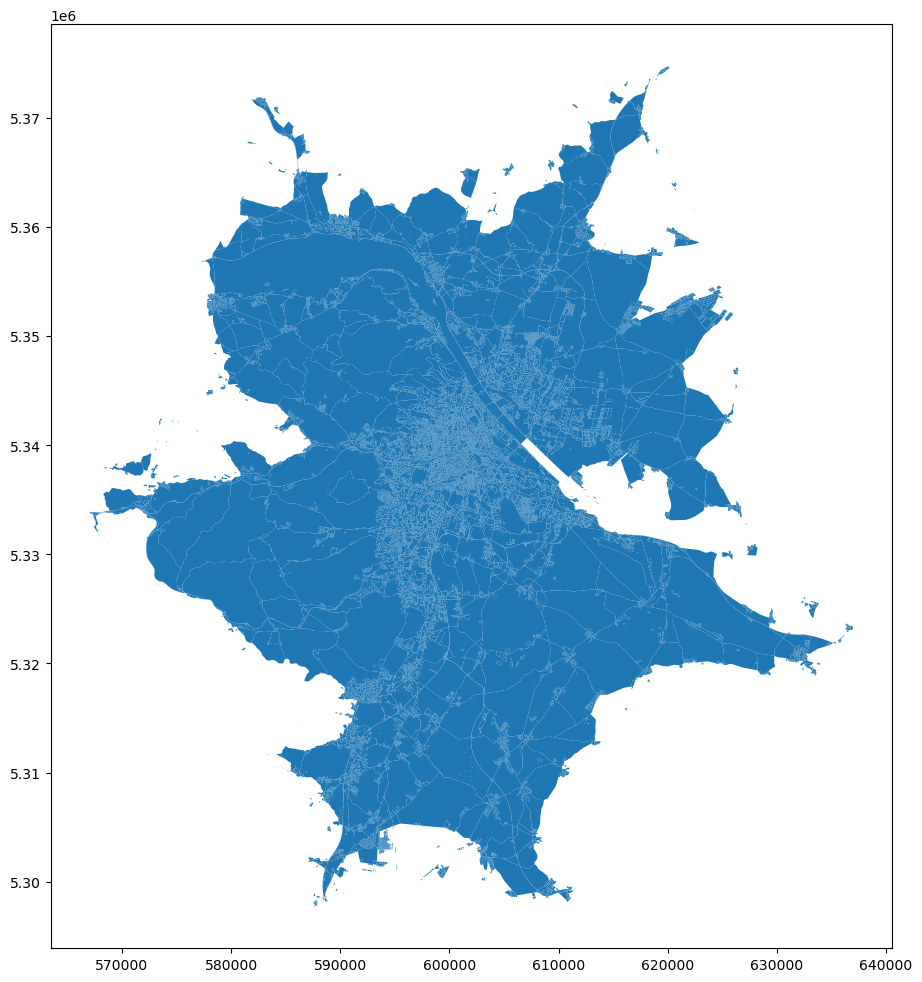

In [116]:
polygons.plot(figsize=(12, 12))

In [118]:
polygons.explore(prefer_canvas=True)

In [119]:
polygons.geom_type.value_counts()

Polygon    31400
dtype: int64